# DDPLKO Moduł 6 - praca domowa - Data augmentation

To szósta praca domowa w Programie szkoleniowym Klasyfikacja obrazu od Deep Drive PL

Twoim zadaniem w tym module będzie:
- [x] Na bazie ostatniej pracy domowej z Transfer learningiem
- [x] Dobierz Data augmentation do zbioru danych, tak aby generowane zdjęcia były podobne do zbioru Val
- [x] Wyświetl przykłady przed i po data augmentation
- [x] Wykonaj trening klasyfikatora oraz całej sieci (fine tuning) wykorzystując data augmentation
- [x] Przygotuj wykres w którym porównasz 2 treningi - bez data augmentation i z data augmentation
- [ ] Udostępnij wykres na Discordzie `#klasyfikacja-wyniki` (val acc)

Możesz (czyli opcjonalne rzeczy):
- wykonać tylko trening klasyfikatora, bez fine tuningu, jeżeli masz ograniczone zasoby
- zwizualizować dodatkowo i wskazać zmiany:
  - [x] confussion matrix - gdzie jest lepiej, gdzie gorzej
  - błędne przypadki - które próbki już są poprawnie klasyfikowane, a które przestały być

In [ ]:
!pip list | grep opencv
!pip install opencv-contrib-python==4.5.5.64 --quiet
!pip install opencv-python==4.5.5.64 --quiet
!pip install timm --quiet
!pip install albumentations==0.4.6 --quiet

opencv-contrib-python         4.1.2.30
opencv-python                 4.1.2.30
     |████████████████████████████████| 66.7 MB 2.1 MB/s 
     |████████████████████████████████| 60.5 MB 1.2 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 431 kB 4.0 MB/s 
     |████████████████████████████████| 117 kB 4.1 MB/s 
     |████████████████████████████████| 948 kB 31.0 MB/s 


# Sourcing data

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import Dataset
from torch.utils import tensorboard
from datetime import datetime
from PIL import Image
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
import torch
from sklearn.metrics import confusion_matrix

import urllib.request
import progressbar
import glob
import zipfile
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

sns.set(style='white', font_scale=1.5)
pbar = None


def show_progress(block_num, block_size, total_size):
    global pbar
    if pbar is None:
        pbar = progressbar.ProgressBar(maxval=total_size)
        pbar.start()

    downloaded = block_num * block_size
    if downloaded < total_size:
        pbar.update(downloaded)
    else:
        pbar.finish()
        pbar = None

if 'dataset.7z' not in glob.glob('*'):
  urllib.request.urlretrieve('https://dataverse.nl/api/access/datafile/14166?format=original&gbrecs=true', 'dataset.7z', show_progress)

if 'dataset' not in glob.glob("*"):
  !7z e dataset.7z

if 'Wild_Anim_Dataset' not in glob.glob("*"):
  !unzip Wild_Anim_Dataset.zip
if 'dataset' not in glob.glob("*"):
  !unzip Wild_Anim_Dataset/Wild_Anim_Dataset.zip
if 'dataset' not in glob.glob("*"):
  !mv Wild_Anim_Dataset/Wild_Anim_5000_images dataset

In [ ]:
import numpy as np
from skimage.transform import resize

class_names = [i.replace('dataset/', '') for i in glob.glob("dataset/*")]
data = []
X = np.zeros((5000, 3, 150, 150))
for i, name in enumerate(class_names):
    images = glob.glob('dataset/' + name + '/*')
    for j, file in enumerate(images):
        img = np.asarray(Image.open(file))
        if img.shape != (150, 150, 3):
            img = resize(img, (150, 150)) * 255
        img = img.transpose((2, 0, 1)) / 255
        X[i * 1000 + j] = img

y = np.concatenate([np.array([i] * 1000) for i in range(len(class_names))],
                   axis=0)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

# Data augmentation

In [ ]:
import albumentations as A
from torchvision import datasets, transforms
from albumentations.pytorch import ToTensorV2

In [ ]:
class ZooDataset(Dataset):

    def __init__(self, X, y, transform=None):
        self.data = torch.Tensor(X)
        self.targets = torch.Tensor(y)
        self.transform = transform

    def __getitem__(self, index):
        img, target = self.data[index], int(self.targets[index])

        if self.transform is not None:
            img = np.array(img).transpose(1, 2, 0)
            if np.max(img) > 1:
                img = img / 255
            img = img.astype(np.float32)
            augmented = self.transform(img=img)
            img = augmented
        return img, target

    def __len__(self):
        return len(self.targets)


In [ ]:
aggresive_augmentation = transforms.Compose([
                                      transforms.Lambda(lambda img: A.Blur(blur_limit=(1,5))(image=img)['image']),
                                      transforms.Lambda(lambda img: A.HorizontalFlip()(image=img)['image']),
                                      transforms.Lambda(lambda img: A.Rotate(90, border_mode=0, value=0)(image=img)['image']),
                                      transforms.Lambda(lambda img: A.RandomBrightnessContrast(brightness_limit=0.4, contrast_limit=0.5)(image=img)['image']),
                                      transforms.Lambda(lambda img: A.GridDistortion()(image=img)['image']),
                                      transforms.ToTensor(),
                                      ])

medium_augmentation = transforms.Compose([
                                      transforms.Lambda(lambda img: A.Blur(blur_limit=(1,3))(image=img)['image']),
                                      transforms.Lambda(lambda img: A.HorizontalFlip()(image=img)['image']),
                                      transforms.Lambda(lambda img: A.Rotate(20, border_mode=0, value=0)(image=img)['image']),
                                      transforms.Lambda(lambda img: A.RandomBrightnessContrast()(image=img)['image']),
                                      transforms.ToTensor(),
                                      ])

mild_augmentation = transforms.Compose([
                                      transforms.Lambda(lambda img: A.Blur(blur_limit=(1,2))(image=img)['image']),
                                      transforms.Lambda(lambda img: A.HorizontalFlip()(image=img)['image']),
                                      transforms.Lambda(lambda img: A.Rotate(10, border_mode=0, value=0)(image=img)['image']),
                                      transforms.Lambda(lambda img: A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1)(image=img)['image']),
                                      transforms.ToTensor(),
                                      ])

In [ ]:
train_mild = ZooDataset(X_train, y_train, transform=mild_augmentation)
train_medium = ZooDataset(X_train, y_train, transform=medium_augmentation)
train_aggresive = ZooDataset(X_train,
                             y_train,
                             transform=aggresive_augmentation)

batch_size = 64

train_loader = DataLoader(TensorDataset(torch.Tensor(X_train),
                                        torch.Tensor(y_train)),
                          batch_size=batch_size)
test_loader = DataLoader(TensorDataset(torch.Tensor(X_test),
                                       torch.Tensor(y_test)),
                         batch_size=batch_size)


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Using {} device'.format(device))
torch.device(device)
if device == 'cuda':
    print(torch.cuda.get_device_name())


def to_cpu(train_losses, val_losses, train_accs, val_accs):
    train_losses = [x.cpu() for x in train_losses]
    train_accs = [x.cpu() for x in train_accs]
    val_losses = [x.cpu() for x in val_losses]
    val_accs = [x.cpu() for x in val_accs]
    return train_losses, val_losses, train_accs, val_accs


Using cuda device
Tesla P100-PCIE-16GB


In [ ]:
%load_ext tensorboard
histories_torch=[]

In [ ]:
%tensorboard --logdir logs/pt

<IPython.core.display.Javascript object>

## Data augmentation - examples

## No augmentation

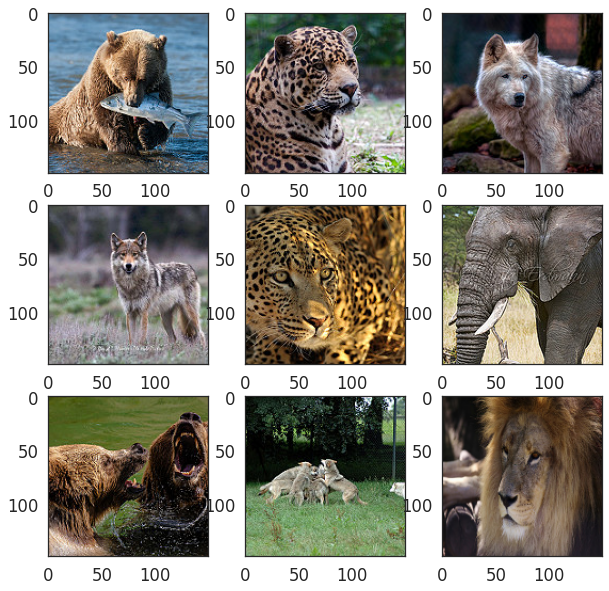

In [ ]:
batch = next(iter(train_loader))
plt.figure(figsize=(10, 10))
for i, (img, target) in enumerate(zip(batch[0], batch[1])):
    if i > 8:
        break
    plt.subplot(3, 3, 1 + i)
    plt.imshow(img.permute(1, 2, 0))


## Mild augmentation

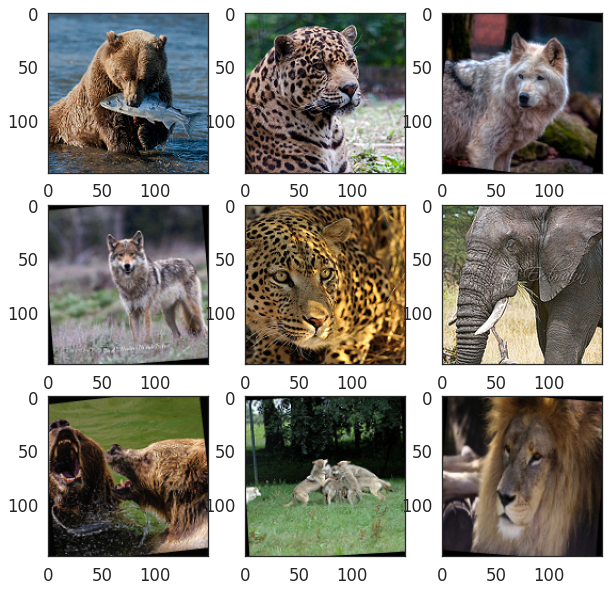

In [ ]:
batch = next(iter(DataLoader(train_mild, batch_size=9)))
plt.figure(figsize=(10, 10))
for i, (img, target) in enumerate(zip(batch[0], batch[1])):
    plt.subplot(3, 3, 1 + i)
    plt.imshow(img.permute(1, 2, 0))


## Medium augmentation

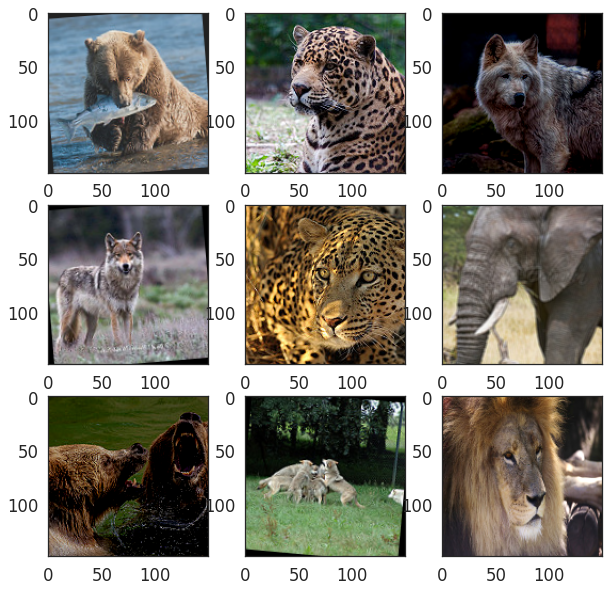

In [ ]:
batch = next(iter(DataLoader(train_medium, batch_size=9)))
plt.figure(figsize=(10, 10))
for i, (img, target) in enumerate(zip(batch[0], batch[1])):
    plt.subplot(3, 3, 1 + i)
    plt.imshow(img.permute(1, 2, 0))


## Aggresive augmentation

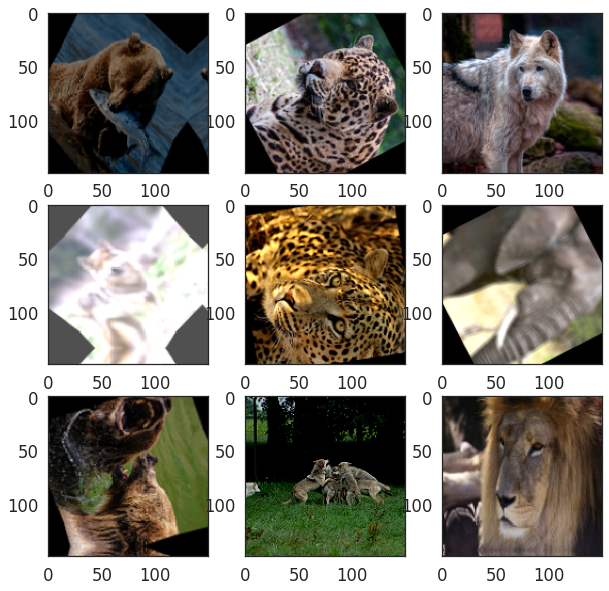

In [ ]:
batch = next(iter(DataLoader(train_aggresive, batch_size=9)))
plt.figure(figsize=(10, 10))
for i, (img, target) in enumerate(zip(batch[0], batch[1])):
    plt.subplot(3, 3, 1 + i)
    plt.imshow(img.permute(1, 2, 0))


# Model

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


def train_and_eval(model,
                   optimizer,
                   scheduler,
                   last_epoch=0,
                   confuse=False,
                   train_loader=train_loader):
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []

    print('Params:', count_parameters(model))

    for epoch in tqdm(list(range(epochs))):
        model.train()
        train_loss = 0
        correct = 0
        for batch_idx, (data, target) in enumerate(tqdm(train_loader)):
            target = target.type(torch.LongTensor)
            data, target = data.to(device), target.to(device)
            optimizer.zero_grad()
            output = model(data)
            loss = F.nll_loss(F.softmax(output, dim=1), target)

            loss.backward()
            optimizer.step()

            pred = output.argmax(dim=1, keepdim=True)
            correct += pred.eq(target.view_as(pred)).sum().detach()
            train_loss += loss.detach()

        scheduler.step()
        train_loss /= len(train_loader)
        acc = correct / float(len(train_loader.dataset))
        train_losses.append(train_loss)
        train_accs.append(acc)

        model.eval()
        val_loss = 0
        correct = 0
        all_pred = []
        all_true = []
        with torch.no_grad():
            for data, target in test_loader:
                target = target.type(torch.LongTensor)
                data, target = data.to(device), target.to(device)
                output = model(data)
                val_loss += F.nll_loss(
                    F.softmax(output, dim=1), target,
                    reduction='sum').detach()  # sum up batch loss
                pred = output.argmax(dim=1, keepdim=True)
                correct += pred.eq(target.view_as(pred)).sum().detach()
                all_pred.extend(list(np.ravel(pred.cpu().numpy())))
                all_true.extend(list(target.cpu().numpy()))

        val_loss /= len(test_loader.dataset)
        val_acc = correct / float(len(test_loader.dataset))
        val_losses.append(val_loss)
        val_accs.append(val_acc)

        writer.add_scalar('Loss/train', train_loss, epoch + last_epoch)
        writer.add_scalar('Loss/test', val_loss, epoch + last_epoch)
        writer.add_scalar('Accuracy/train', acc, epoch + last_epoch)
        writer.add_scalar('Accuracy/test', val_acc, epoch + last_epoch)
        if confuse:
            cm = confusion_matrix(all_pred, all_true)
            fig, ax = plt.subplots(figsize=(15, 15))
            sns.heatmap(cm, annot=True, cbar=False, ax=ax)
            ax.set_xticklabels(class_names, rotation=0)
            ax.set_yticklabels(class_names,
                               rotation=0,
                               ha='center',
                               va='center')
            ax.tick_params(axis='y', pad=40)
            ax.set(xlabel='Predicted label', ylabel='True label')
            writer.add_figure('Val/Confusion Matrix', ax.get_figure(),
                              epoch + last_epoch)

    return train_losses, val_losses, train_accs, val_accs

In [ ]:
import timm
from torchsummary import summary

In [ ]:
epochs = 100
model_name = 'mnasnet_small'

## Mild augmentation


In [ ]:
unique_name = datetime.now().strftime("%Y_%m_%d-%H_%M_%S")
writer = tensorboard.SummaryWriter('./logs/pt/mild_augmentation_transfer' +
                                   unique_name)

model = timm.create_model(model_name,
                          pretrained=True,
                          num_classes=len(class_names))

total = len([1 for _ in model.parameters()])
for i, param in enumerate(model.parameters()):
    if i >= (total - 2):
        param.requires_grad = True
    else:
        param.requires_grad = False

model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)


Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/mnasnet_small-eb785140.pth" to /root/.cache/torch/hub/checkpoints/mnasnet_small-eb785140.pth


In [ ]:
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    train_loader=DataLoader(train_mild, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

### Unfreeze model

In [ ]:
for i, param in enumerate(model.parameters()):
    param.requires_grad = True


### Fine tuning with augmentation

In [ ]:
writer = tensorboard.SummaryWriter('./logs/pt/mild_augmentation_fine' +
                                   unique_name)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    last_epoch=epochs,
                    train_loader=DataLoader(train_mild, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

## Medium augmentation


In [ ]:
unique_name = datetime.now().strftime("%Y_%m_%d-%H_%M_%S")
writer = tensorboard.SummaryWriter('./logs/pt/medium_augmentation_transfer' +
                                   unique_name)

model = timm.create_model(model_name,
                          pretrained=True,
                          num_classes=len(class_names))

total = len([1 for _ in model.parameters()])
for i, param in enumerate(model.parameters()):
    if i >= (total - 2):
        param.requires_grad = True
    else:
        param.requires_grad = False

model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)


In [ ]:
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    train_loader=DataLoader(train_medium, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

### Unfreeze model

In [ ]:
for i, param in enumerate(model.parameters()):
    param.requires_grad = True


### Fine tuning with augmentation

In [ ]:
writer = tensorboard.SummaryWriter('./logs/pt/medium_augmentation_fine' +
                                   unique_name)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    last_epoch=epochs,
                    train_loader=DataLoader(train_medium, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

## Agresive augmentation


In [ ]:
unique_name = datetime.now().strftime("%Y_%m_%d-%H_%M_%S")
writer = tensorboard.SummaryWriter(
    './logs/pt/aggresive_augmentation_transfer' + unique_name)

model = timm.create_model(model_name,
                          pretrained=True,
                          num_classes=len(class_names))

total = len([1 for _ in model.parameters()])
for i, param in enumerate(model.parameters()):
    if i >= (total - 2):
        param.requires_grad = True
    else:
        param.requires_grad = False

model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)


In [ ]:
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    train_loader=DataLoader(train_aggresive, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

### Unfreeze model

In [ ]:
for i, param in enumerate(model.parameters()):
    param.requires_grad = True


### Fine tuning with augmentation

In [ ]:
writer = tensorboard.SummaryWriter('./logs/pt/aggresive_augmentation_fine' +
                                   unique_name)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    last_epoch=epochs,
                    train_loader=DataLoader(train_aggresive, batch_size=64)))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

# No augmentation vs augmentation

In [ ]:
unique_name = datetime.now().strftime("%Y_%m_%d-%H_%M_%S")
writer = tensorboard.SummaryWriter('./logs/pt/no_augmentation_transfer' +
                                   unique_name)

model = timm.create_model(model_name,
                          pretrained=True,
                          num_classes=len(class_names))

total = len([1 for _ in model.parameters()])
for i, param in enumerate(model.parameters()):
    if i >= (total - 2):
        param.requires_grad = True
    else:
        param.requires_grad = False

model = model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)


In [ ]:
train_losses, val_losses, train_accs, val_accs = to_cpu(*train_and_eval(
    model, optimizer, scheduler, confuse=True, train_loader=train_loader))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

In [ ]:
for i, param in enumerate(model.parameters()):
    param.requires_grad = True


In [ ]:
writer = tensorboard.SummaryWriter('./logs/pt/no_augmentation_fine' +
                                   unique_name)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                            step_size=100,
                                            gamma=0.1)
train_losses, val_losses, train_accs, val_accs = to_cpu(
    *train_and_eval(model,
                    optimizer,
                    scheduler,
                    confuse=True,
                    last_epoch=epochs,
                    train_loader=train_loader))
histories_torch.append((train_losses, val_losses, train_accs, val_accs))

# Summary / extra

# [Link do tensorboarda](https://tensorboard.dev/experiment/KYQaVJkHRhq7eKDewCmnhA/#scalars&_smoothingWeight=0)



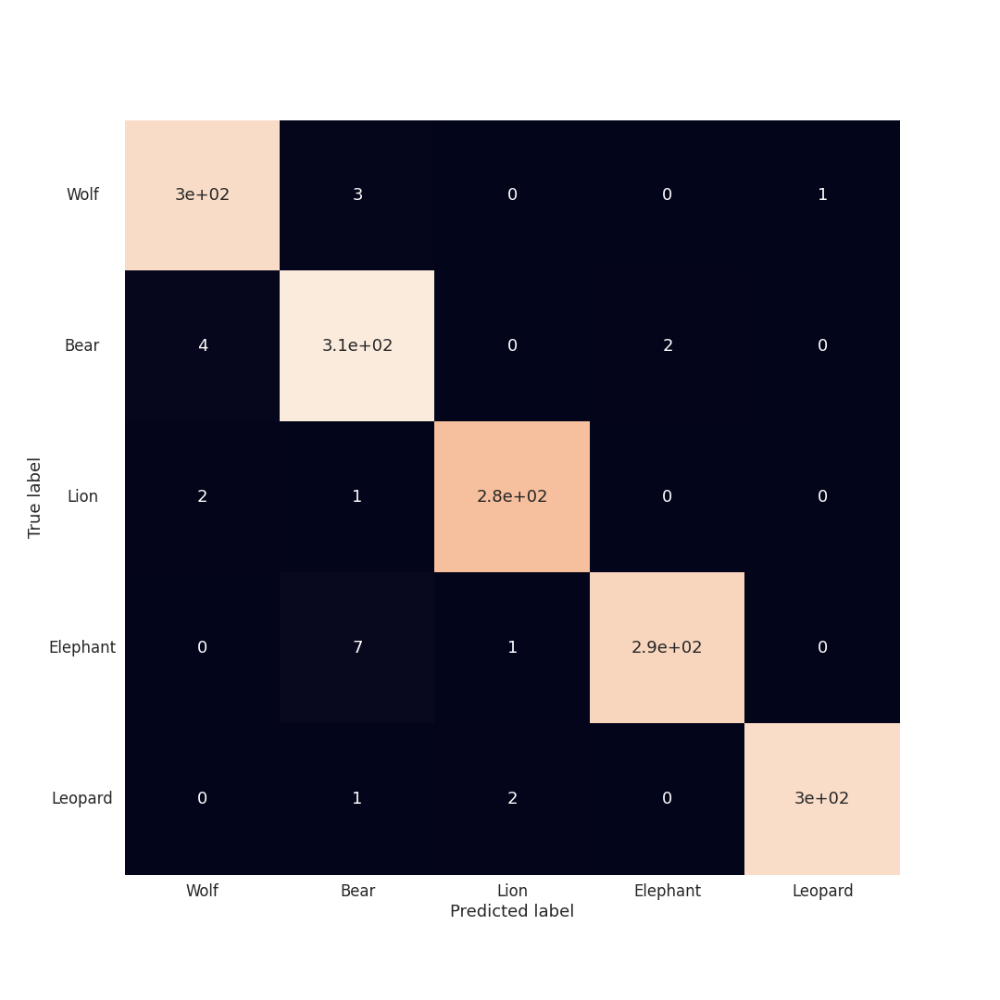